In [1]:
import scanpy as sc
import pandas as pd
import numpy as np
import anndata
import scipy

import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
import session_info
session_info.show()

In [3]:
sc.settings.set_figure_params(dpi=120)

# Read in

In [85]:
adata = sc.read_h5ad('/nfs/team205/heart/anndata_objects/Foetal/vCM/MultiVI-post_foetal_vCM_onlyMultiome_allregion_onlyLeft_feature-select-001.h5ad')
adata

AnnData object with n_obs × n_vars = 16451 × 174604
    obs: 'sangerID', 'combinedID', 'donor', 'region', 'age', 'sex', 'facility', 'cell_or_nuclei', 'modality', 'kit_10x', 'week', 'trimester', 'cycling', 'S_score', 'G2M_score', 'phase', 'fine_grain', 'mid_grain', 'coarse_grain', 'batch_key', 'total_counts', 'total_counts_mt', 'total_counts_ribo', 'n_genes_by_counts', 'pct_counts_mt', 'pct_counts_ribo', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'log1p_total_counts_mt', 'log1p_total_counts_ribo', 'scrublet_score', 'doublet_pval', 'doublet_bh_pval', '_indices', '_scvi_batch', '_scvi_labels', 'leiden_MultiVI'
    var: 'modality', 'gene_name_scRNA-0', 'gene_id', 'seqnames', 'start', 'end', 'width', 'strand', 'score', 'replicateScoreQuantile', 'groupScoreQuantile', 'Reproducibility', 'GroupReplicate', 'distToGeneStart', 'nearestGene', 'peakType', 'distToTSS', 'nearestTSS', 'GC', 'idx', 'N', 'n_cells'
    uns: '_scvi_manager_uuid', '_scvi_uuid', 'cycling_colors', 'donor_colors', 'fine

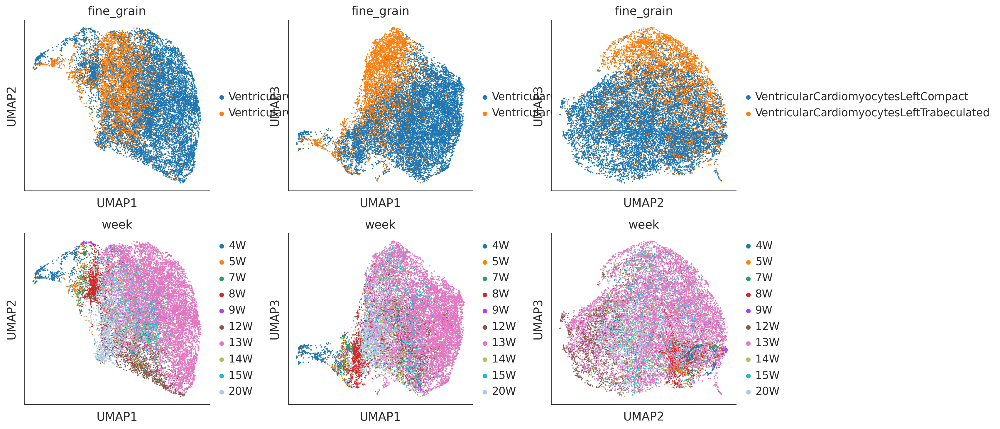

In [86]:
sc.pl.umap(adata, color=['fine_grain','week'], size=10, wspace=0.3, components='all', ncols=3)

/home/jovyan/my-conda-envs/vitro/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:1227: FutureWarning: In a future version of pandas all arguments of Categorical.replace except for the argument 'value' will be keyword-only.
  values = values.replace(values.categories.difference(groups), np.nan)
/home/jovyan/my-conda-envs/vitro/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:1227: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)
/home/jovyan/my-conda-envs/vitro/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:1227: FutureWarning: In a future version of pandas all arguments of Categorical.replace except for the argument 'value' will be keyword-only.
  values = values.replace(values.categories.difference(groups), np.nan)
/home/jovyan/my-conda-envs/vitro/lib/python3.8/site-packages/scanpy

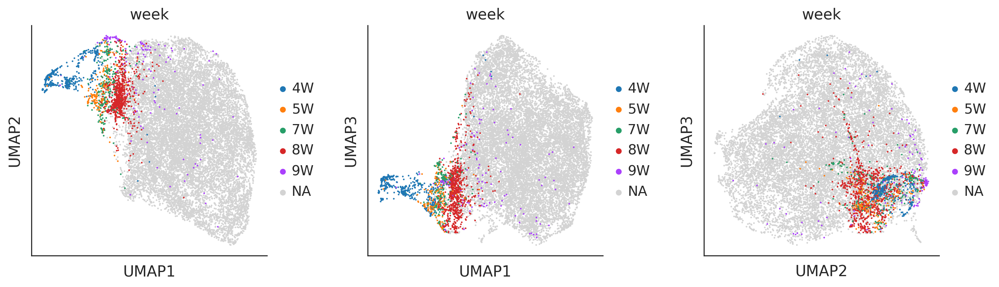

In [87]:
sc.pl.umap(adata, color=['week'], groups=['4W','5W','7W','8W','9W',], size=10, wspace=0.3, components='all', ncols=3)

/home/jovyan/my-conda-envs/vitro/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:1227: FutureWarning: In a future version of pandas all arguments of Categorical.replace except for the argument 'value' will be keyword-only.
  values = values.replace(values.categories.difference(groups), np.nan)
/home/jovyan/my-conda-envs/vitro/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:1227: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)
/home/jovyan/my-conda-envs/vitro/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:1227: FutureWarning: In a future version of pandas all arguments of Categorical.replace except for the argument 'value' will be keyword-only.
  values = values.replace(values.categories.difference(groups), np.nan)
/home/jovyan/my-conda-envs/vitro/lib/python3.8/site-packages/scanpy

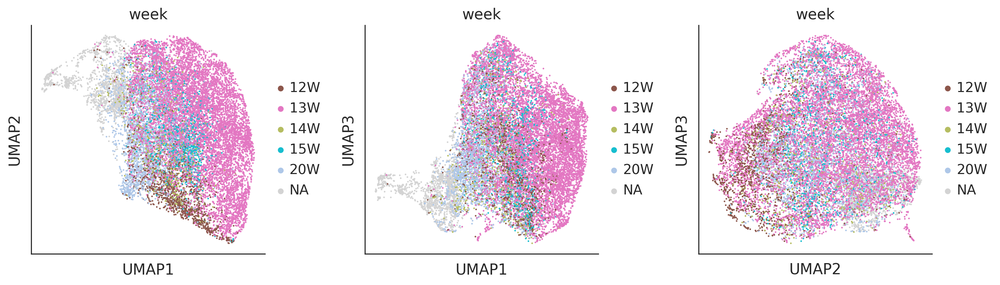

In [88]:
sc.pl.umap(adata, color=['week'], groups=['12W','13W','14W','15W','20W',], size=10, wspace=0.3, components='all', ncols=3)

# scFates - Tree analysis

ref: https://scfates.readthedocs.io/en/latest/Tree_Analysis_Bone_marrow_fates.html

In [11]:
import scFates as scf
import palantir

findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.


## Preprocessing pipeline from Palantir

### Create projection dataframe

* MultiVI latent space

In [89]:
projections = pd.DataFrame(adata.obsm["MultiVI_latent"],index=adata.obs_names)
projections

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
barcode,,,,,,,,,,,,,,,,,,,,
BHF_F_Hea11933669_BHF_F_Hea11596622_AATTAGCGTTAGCATG-1,-1.878157,1.835245,1.792730,-0.027374,-0.868398,0.957157,-0.887397,-0.003470,-2.320858,0.009295,-0.242407,-1.068807,-2.260582,3.083496,-0.963072,-1.438524,-1.684607,-1.767819,0.173834,-3.219170
HCAHeartST13386009_HCAHeartST13303419_ATCCTTAGTGGATTGC-1,1.393624,0.261571,0.184448,0.968712,-0.084678,0.515986,-0.301712,1.213085,-1.226424,0.386641,-0.207488,-1.048345,-0.273391,-0.075548,0.345999,1.003559,-0.938865,-0.259722,-0.014199,0.112848
BHF_F_Hea13188324_BHF_F_Hea13187626_CGAGGCAAGGCTGTCA-1,1.490069,-0.094814,-0.304887,0.579783,0.263553,-0.254036,-0.050010,0.549531,-0.402809,0.566203,0.243366,-0.784993,0.297039,-0.547319,0.466746,0.583219,-0.090199,0.195210,0.113946,0.678926
BHF_F_Hea13188324_BHF_F_Hea13187626_TAGTAAGCACATACTG-1,2.424270,-0.265696,-0.149202,-0.015023,-1.113774,-0.685063,-0.363911,0.178502,1.770646,1.158291,0.344766,-0.514303,0.270054,-1.972613,-0.600173,1.571782,-0.538324,-0.649703,0.660250,1.747086
BHF_F_Hea13188324_BHF_F_Hea13187626_GTTTAACCACGTAATT-1,2.376579,0.229350,0.330988,0.943465,-1.601969,0.533309,-0.469471,1.353667,0.263105,0.975063,0.006556,-1.451082,-0.736068,-1.000846,-0.082811,2.109113,-1.320644,-1.642327,0.314539,0.736304
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
BHF_F_Hea11933669_BHF_F_Hea11596622_GCCCAAATCACATTGA-1,-0.605127,-0.260795,0.436648,-0.739891,-0.505763,-0.603215,1.311260,0.203820,-0.444428,0.494107,0.029668,0.549115,-1.078384,1.221829,1.002876,-1.309394,0.696606,-1.019015,-0.686481,-0.975671
BHF_F_Hea11933667_BHF_F_Hea11596620_CGCAATTAGGTCTTGG-1,-0.222373,0.437066,0.458659,0.361385,0.152605,0.403418,0.130209,0.601426,-1.630552,0.015598,-0.239839,-0.481973,-0.694122,1.162804,0.524883,-0.458605,-0.338760,-0.258777,-0.339770,-0.978922
BHF_F_Hea11933667_BHF_F_Hea11596620_GCGCTTGCAGGATGGC-1,1.284582,-0.278768,-0.298584,-0.321449,0.279498,-1.031224,-0.038410,-0.418410,0.653406,0.707402,0.483479,0.030240,0.565470,-0.933202,-0.010066,-0.087492,0.474503,0.432114,0.306019,1.044283


### Run Palantir to obtain multiscale diffusion space

In [90]:
# fate probability mapping of the cells
dm_res = palantir.utils.run_diffusion_maps(projections,knn=30)
ms_data = palantir.utils.determine_multiscale_space(dm_res,n_eigs=5)

Determing nearest neighbor graph...


### Generate embedding from the multiscale diffusion space

In [91]:
# Generate embedding from the multiscale diffusion space
adata.obsm["X_palantir"]=ms_data.values
sc.pp.neighbors(adata,n_neighbors=30,use_rep="X_palantir")

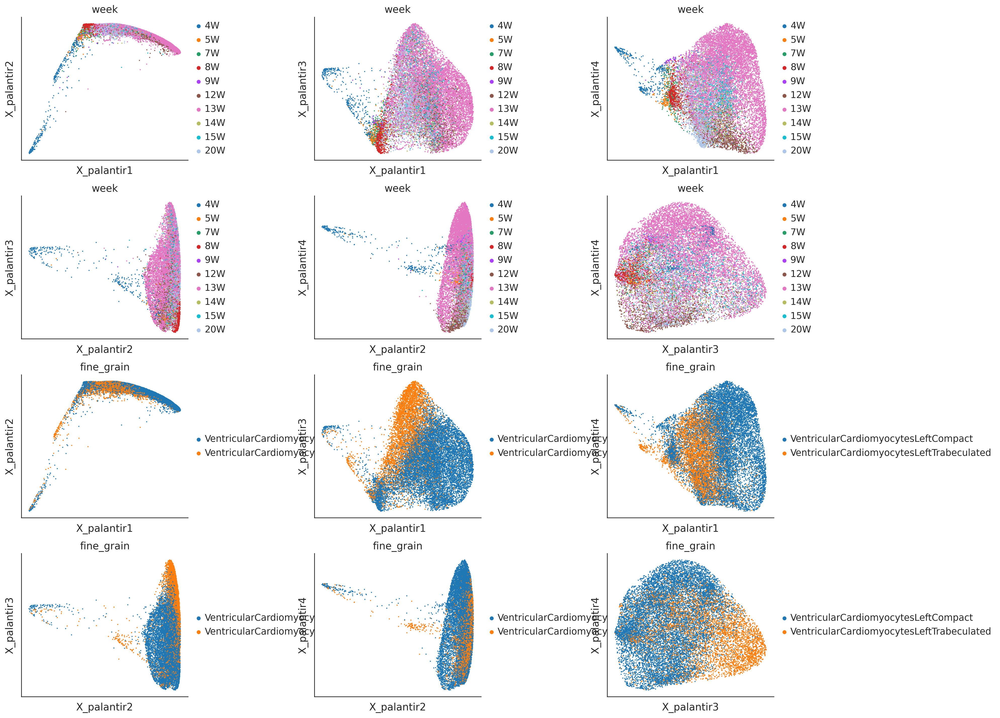

In [92]:
sc.pl.embedding(adata, basis='X_palantir',color=['week','fine_grain'], components='all',ncols=3,wspace=0.6,size=10)

In [93]:
%%time
# draw ForceAtlas2 embedding using UMAP dim1 and dim2 as initial position
adata.obsm['X_umap13'] = adata.obsm['X_umap'][:,[0,2]]
# adata.obsm['X_palantir12'] = adata.obsm['X_palantir'][:,[0,1]]
sc.tl.draw_graph(adata,init_pos='X_umap13',random_state=0)

CPU times: user 2min 23s, sys: 23.1 ms, total: 2min 23s
Wall time: 2min 23s


### Plotting

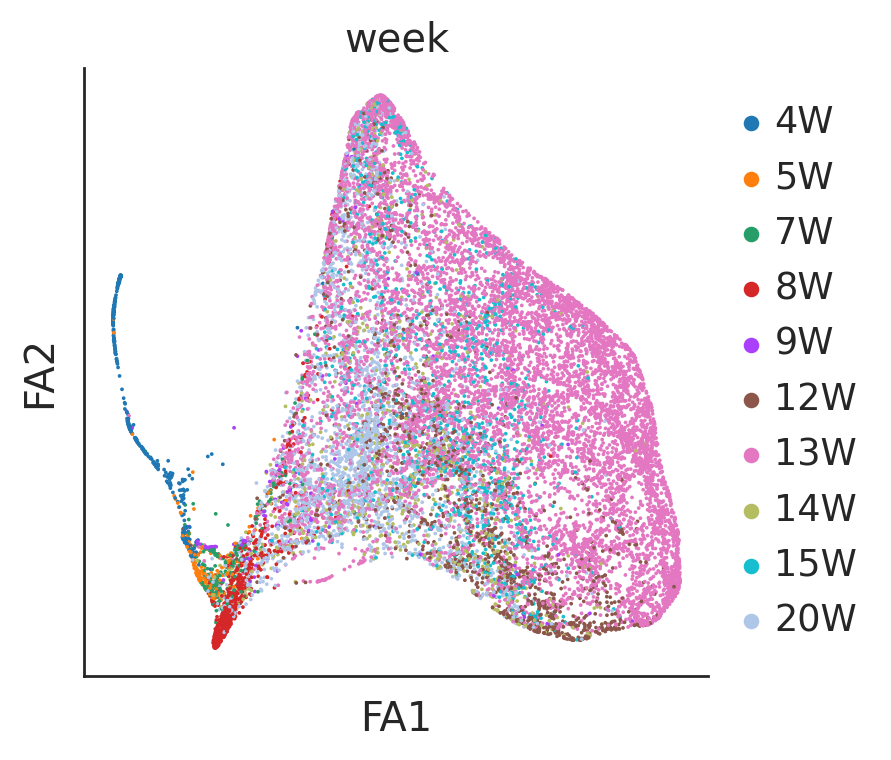

In [94]:
# adata.uns["week_colors"][list(adata.obs['week'].cat.categories).index('13W')]='purple'
sc.pl.draw_graph(adata,color="week",color_map="RdBu_r")

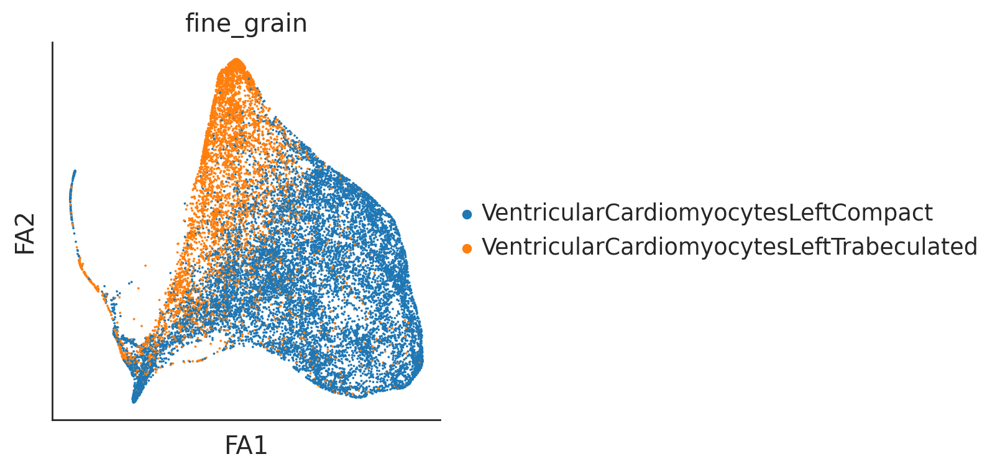

In [95]:
sc.pl.draw_graph(adata,color="fine_grain",color_map="RdBu_r")

## Tree learning with SimplePPT (or ElPiGraph)

* User has the choice to running either ElPiGraph or SimplePPT algorithm to leanr a principal graph
* To get a "middle" of the data (nodes connected by edges)

In [155]:
scf.tl.tree(adata,method="ppt",Nodes=40,use_rep="palantir",
            device="cpu",seed=5,ppt_lambda=100,ppt_sigma=0.025,ppt_nsteps=200)

inferring a principal tree --> parameters used 
    40 principal points, sigma = 0.025, lambda = 100, metric = euclidean
    fitting:  29%|██▉       | 58/200 [00:04<00:10, 13.10it/s]
    converged
    finished (0:00:04) --> added 
    .uns['ppt'], dictionnary containing inferred tree.
    .obsm['X_R'] soft assignment of cells to principal points.
    .uns['graph']['B'] adjacency matrix of the principal points.
    .uns['graph']['F'] coordinates of principal points in representation space.


### Projecting results onto ForceAtlas2 embedding

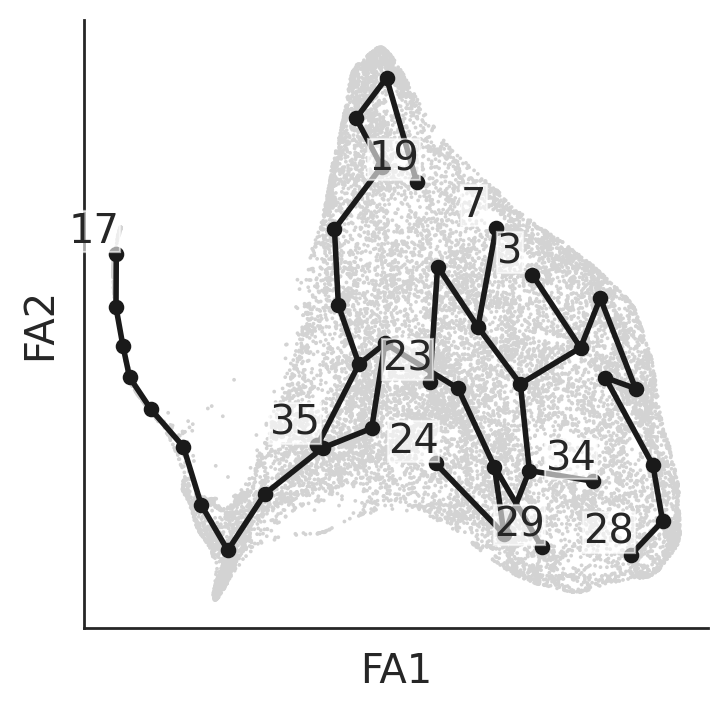

In [156]:
scf.pl.graph(adata,tips=True,forks=False)

### Slecting roots and computing pseudotime

In [157]:
# Selecting a root and computing pseudotime
scf.tl.root(adata,17)
# generate 100 mappings of pseudotime, to account for cell asssignment uncertainty.
# .obs will be saved the mean of all calculated pseudotimes.
scf.tl.pseudotime(adata,n_jobs=1,n_map=1,seed=40)

node 17 selected as a root --> added
    .uns['graph']['root'] selected root.
    .uns['graph']['pp_info'] for each PP, its distance vs root and segment assignment.
    .uns['graph']['pp_seg'] segments network information.
projecting cells onto the principal graph
    finished (0:00:16) --> added
    .obs['edge'] assigned edge.
    .obs['t'] pseudotime value.
    .obs['seg'] segment of the tree assigned.
    .obs['milestones'] milestone assigned.
    .uns['pseudotime_list'] list of cell projection from all mappings.


## Representing the trajectory and tree (on top of existing embedding)

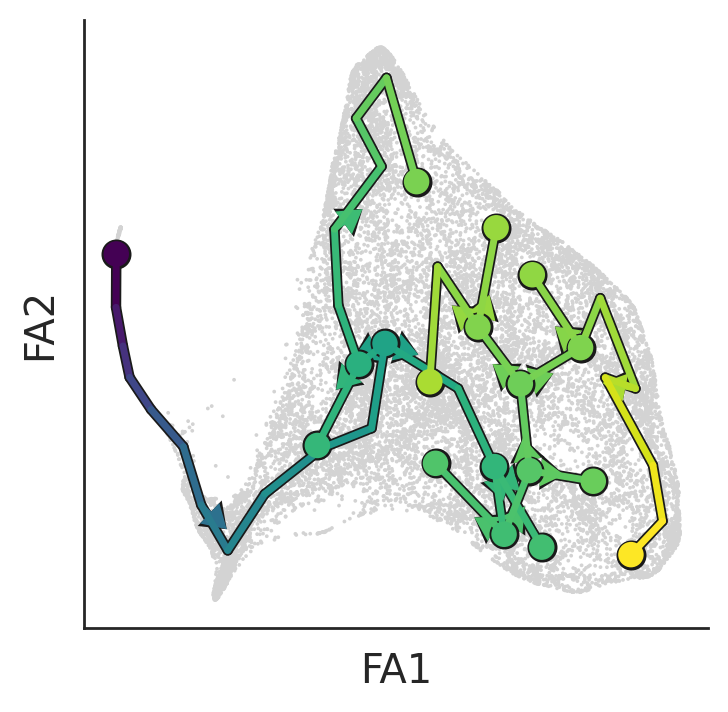

In [159]:
scf.pl.trajectory(adata,arrows=True,arrow_offset=3,scale_path=0.5,
                 )

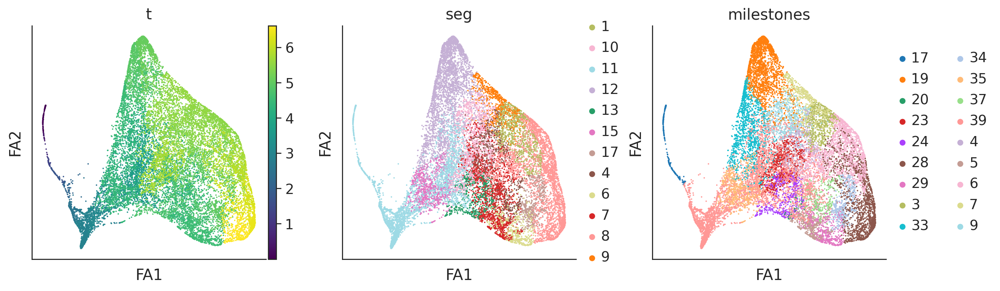

In [160]:
sc.pl.draw_graph(adata, color=["t","seg","milestones"], cmap='viridis')

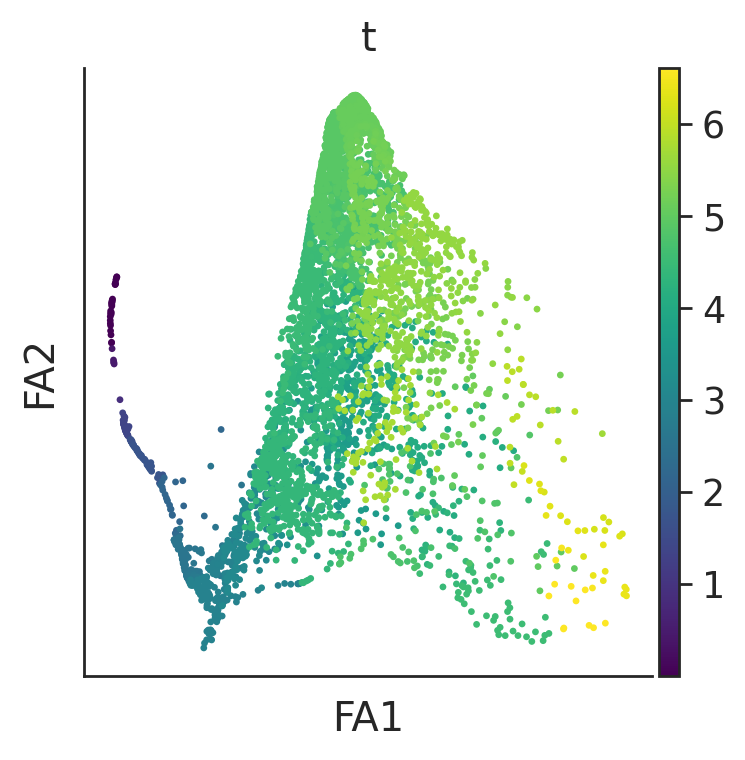

In [161]:
sc.pl.draw_graph(adata[adata.obs['fine_grain']=='VentricularCardiomyocytesLeftTrabeculated'], 
                 color=["t"], cmap='viridis')

In [162]:
adata.obs['fine_grain'].value_counts()

VentricularCardiomyocytesLeftCompact         11397
VentricularCardiomyocytesLeftTrabeculated     5054
Name: fine_grain, dtype: int64

# Recover full genes

In [163]:
# read in anndata which has all the features
adata_all = sc.read_h5ad('/nfs/team205/heart/anndata_objects/Foetal/vCM/MultiVI-pre_paired_foetal_vCMs_raw.h5ad')

# create new anndata
adata_new = anndata.AnnData(X=adata_all[adata.obs_names,:].X, # from all feature data
                      obs=adata.obs, 
                      var=adata_all.var, # from all feature data
                      uns=adata.uns,
                      obsm=adata.obsm, 
                      obsp=adata.obsp 
                               )
adata_new

AnnData object with n_obs × n_vars = 16451 × 544641
    obs: 'sangerID', 'combinedID', 'donor', 'region', 'age', 'sex', 'facility', 'cell_or_nuclei', 'modality', 'kit_10x', 'week', 'trimester', 'cycling', 'S_score', 'G2M_score', 'phase', 'fine_grain', 'mid_grain', 'coarse_grain', 'batch_key', 'total_counts', 'total_counts_mt', 'total_counts_ribo', 'n_genes_by_counts', 'pct_counts_mt', 'pct_counts_ribo', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'log1p_total_counts_mt', 'log1p_total_counts_ribo', 'scrublet_score', 'doublet_pval', 'doublet_bh_pval', '_indices', '_scvi_batch', '_scvi_labels', 'leiden_MultiVI', 't', 'seg', 'edge', 'milestones', 'age_days', 'week_cont'
    var: 'modality', 'gene_name_scRNA-0', 'gene_id', 'seqnames', 'start', 'end', 'width', 'strand', 'score', 'replicateScoreQuantile', 'groupScoreQuantile', 'Reproducibility', 'GroupReplicate', 'distToGeneStart', 'nearestGene', 'peakType', 'distToTSS', 'nearestTSS', 'GC', 'idx', 'N'
    uns: '_scvi_manager_uuid', '_scv

# Save

### make age continuous

In [164]:
# make time continuous
import re
def age_to_days(age_str):
    match = re.match(r'(\d+)W(\d+)D', age_str)
    if match:
        weeks, days = map(int, match.groups())
        return float(weeks * 7 + days)
    else:
        return None

# Assuming 'adata' is an AnnData object
adata_new.obs['age_days'] = adata_new.obs['age'].apply(age_to_days)
adata_new.obs['age_days'] = adata_new.obs['age_days'].astype(float)

# week
adata_new.obs['week_cont'] = [int(x.replace('W','')) for x in adata_new.obs['week']]

### save

In [165]:
adata_new.write('/nfs/team205/heart/anndata_objects/Foetal/vCM/post_scFate/foetal_vCM_onlyLeft.h5ad')

In [166]:
# Log-normalise
# gene expression
adata_lognorm = adata_new[:,adata_new.var['modality']=='Gene Expression'].copy()
sc.pp.normalize_total(adata_lognorm, target_sum=1e4)
sc.pp.log1p(adata_lognorm)

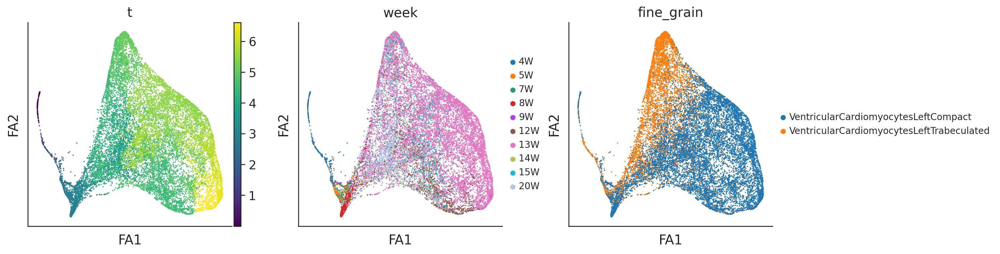

In [167]:
sc.pl.draw_graph(adata_lognorm,color=["t",'week','fine_grain'],legend_fontsize=10, cmap='viridis')

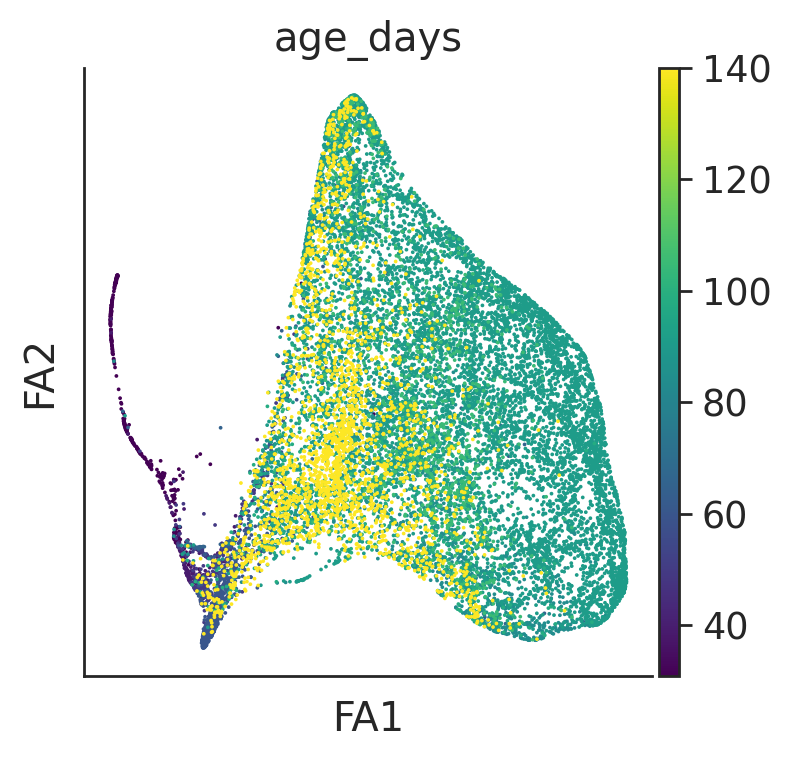

In [168]:
sc.pl.draw_graph(adata_lognorm,color=['age_days'],legend_fontsize=10, cmap='viridis')

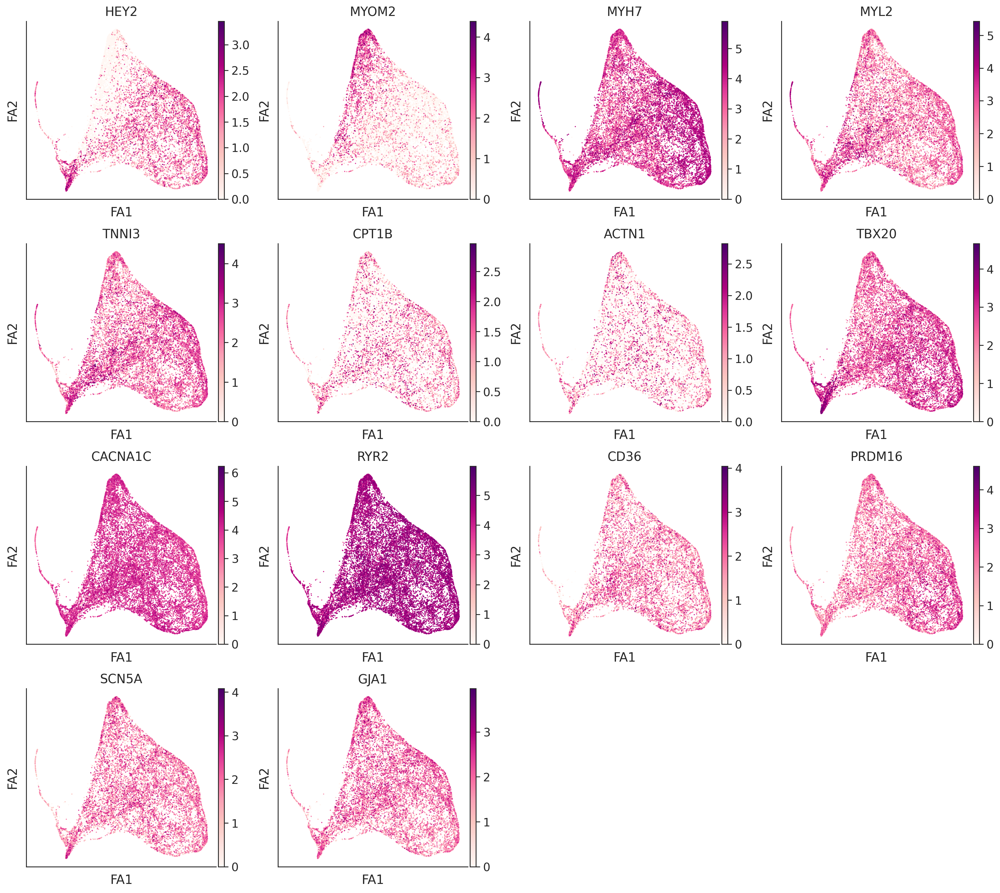

In [169]:
sc.pl.draw_graph(adata_lognorm, color=["HEY2","MYOM2","MYH7","MYL2",'TNNI3','CPT1B','ACTN1','TBX20','CACNA1C','RYR2',
                                       'CD36','PRDM16','SCN5A','GJA1'],legend_loc='on data',legend_fontsize=10, cmap='RdPu')

# Save object separately, Compact, Trab, Gene, and ATAC

In [4]:
adata = sc.read_h5ad('/nfs/team205/heart/anndata_objects/Foetal/vCM/post_scFate/foetal_vCM_onlyLeft.h5ad')
print(adata.X.data[:10])
adata

[1. 2. 3. 2. 5. 3. 2. 1. 1. 1.]


AnnData object with n_obs × n_vars = 16451 × 544641
    obs: 'sangerID', 'combinedID', 'donor', 'region', 'age', 'sex', 'facility', 'cell_or_nuclei', 'modality', 'kit_10x', 'week', 'trimester', 'cycling', 'S_score', 'G2M_score', 'phase', 'fine_grain', 'mid_grain', 'coarse_grain', 'batch_key', 'total_counts', 'total_counts_mt', 'total_counts_ribo', 'n_genes_by_counts', 'pct_counts_mt', 'pct_counts_ribo', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'log1p_total_counts_mt', 'log1p_total_counts_ribo', 'scrublet_score', 'doublet_pval', 'doublet_bh_pval', '_indices', '_scvi_batch', '_scvi_labels', 'leiden_MultiVI', 't', 'seg', 'edge', 'milestones', 'age_days', 'week_cont'
    var: 'modality', 'gene_name_scRNA-0', 'gene_id', 'seqnames', 'start', 'end', 'width', 'strand', 'score', 'replicateScoreQuantile', 'groupScoreQuantile', 'Reproducibility', 'GroupReplicate', 'distToGeneStart', 'nearestGene', 'peakType', 'distToTSS', 'nearestTSS', 'GC', 'idx', 'N'
    uns: '_scvi_manager_uuid', '_scv

In [5]:
adata.var['modality'].value_counts()

Peaks              508040
Gene Expression     36601
Name: modality, dtype: int64

In [6]:
adata.obs['fine_grain'].value_counts()

VentricularCardiomyocytesLeftCompact         11397
VentricularCardiomyocytesLeftTrabeculated     5054
Name: fine_grain, dtype: int64

## Compact

(11397, 544641)


/tmp/ipykernel_468/2720878155.py:7: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_sub.obs['t_binned'] = pd.cut(adata_sub.obs['t'],


t3    7754
t2    3477
t1     166
Name: t_binned, dtype: int64


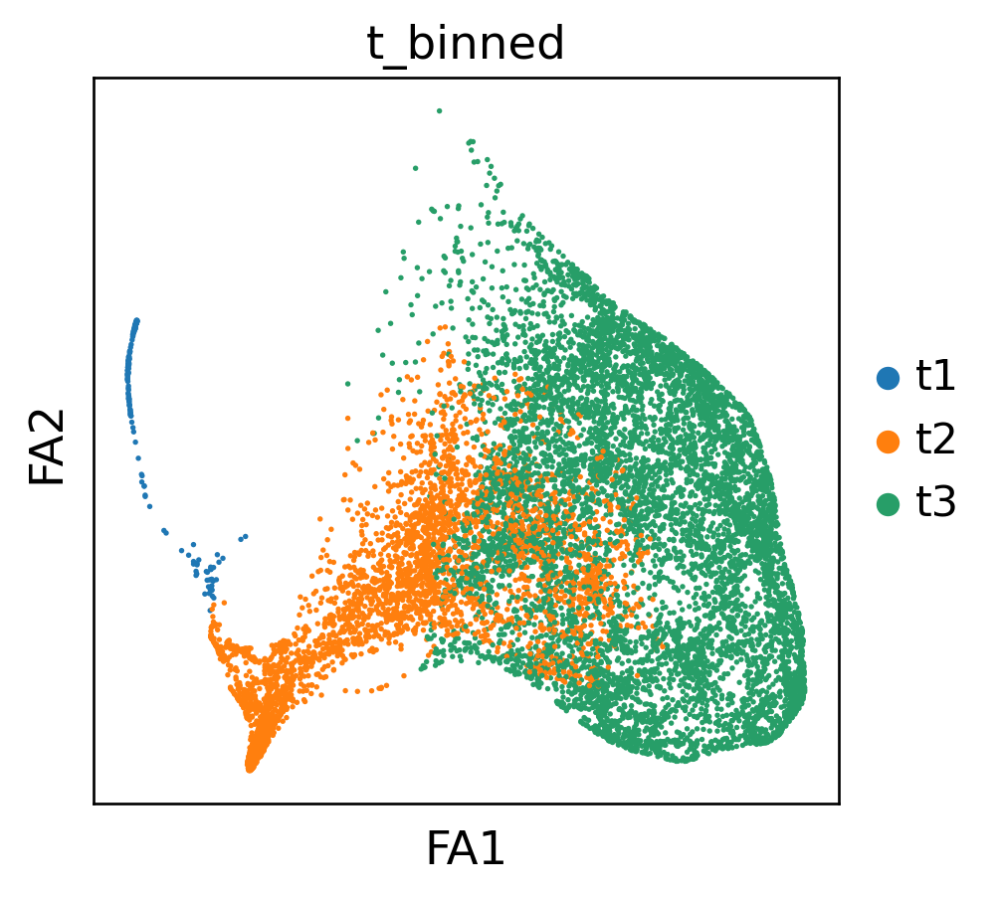

In [11]:
# subset
adata_sub = adata[adata.obs_names[adata.obs['fine_grain']=='VentricularCardiomyocytesLeftCompact']]
print(adata_sub.shape)

# bin t
n_bin_time = 3
adata_sub.obs['t_binned'] = pd.cut(adata_sub.obs['t'],
                               bins=n_bin_time,
                               labels=[f't{str(x+1)}' for x in range(n_bin_time)])
print(adata_sub.obs['t_binned'].value_counts())
sc.pl.draw_graph(adata_sub,color=['t_binned'],color_map="viridis", wspace=0.2)

In [12]:
# save
# RNA
adata_gex = adata_sub[:,adata_sub.var['modality']=='Gene Expression']
adata_gex.write('/nfs/team205/heart/anndata_objects/Vitro/post_multiVI_full-features/Foetal_vCM_Left-compact_rna.h5ad')
print(adata_gex)

# ATAC
adata_atac = adata_sub[:,adata_sub.var['modality']=='Peaks']
adata_atac.write('/nfs/team205/heart/anndata_objects/Vitro/post_multiVI_full-features/Foetal_vCM_Left-compact_atac.h5ad')
print(adata_atac)

View of AnnData object with n_obs × n_vars = 11397 × 36601
    obs: 'sangerID', 'combinedID', 'donor', 'region', 'age', 'sex', 'facility', 'cell_or_nuclei', 'modality', 'kit_10x', 'week', 'trimester', 'cycling', 'S_score', 'G2M_score', 'phase', 'fine_grain', 'mid_grain', 'coarse_grain', 'batch_key', 'total_counts', 'total_counts_mt', 'total_counts_ribo', 'n_genes_by_counts', 'pct_counts_mt', 'pct_counts_ribo', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'log1p_total_counts_mt', 'log1p_total_counts_ribo', 'scrublet_score', 'doublet_pval', 'doublet_bh_pval', '_indices', '_scvi_batch', '_scvi_labels', 'leiden_MultiVI', 't', 'seg', 'edge', 'milestones', 'age_days', 'week_cont', 't_binned'
    var: 'modality', 'gene_name_scRNA-0', 'gene_id', 'seqnames', 'start', 'end', 'width', 'strand', 'score', 'replicateScoreQuantile', 'groupScoreQuantile', 'Reproducibility', 'GroupReplicate', 'distToGeneStart', 'nearestGene', 'peakType', 'distToTSS', 'nearestTSS', 'GC', 'idx', 'N'
    uns: '_scvi_m

## Trabeculated

(5054, 544641)


/tmp/ipykernel_468/2639444817.py:7: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_sub.obs['t_binned'] = pd.cut(adata_sub.obs['t'],


t3    3021
t2    1886
t1     147
Name: t_binned, dtype: int64


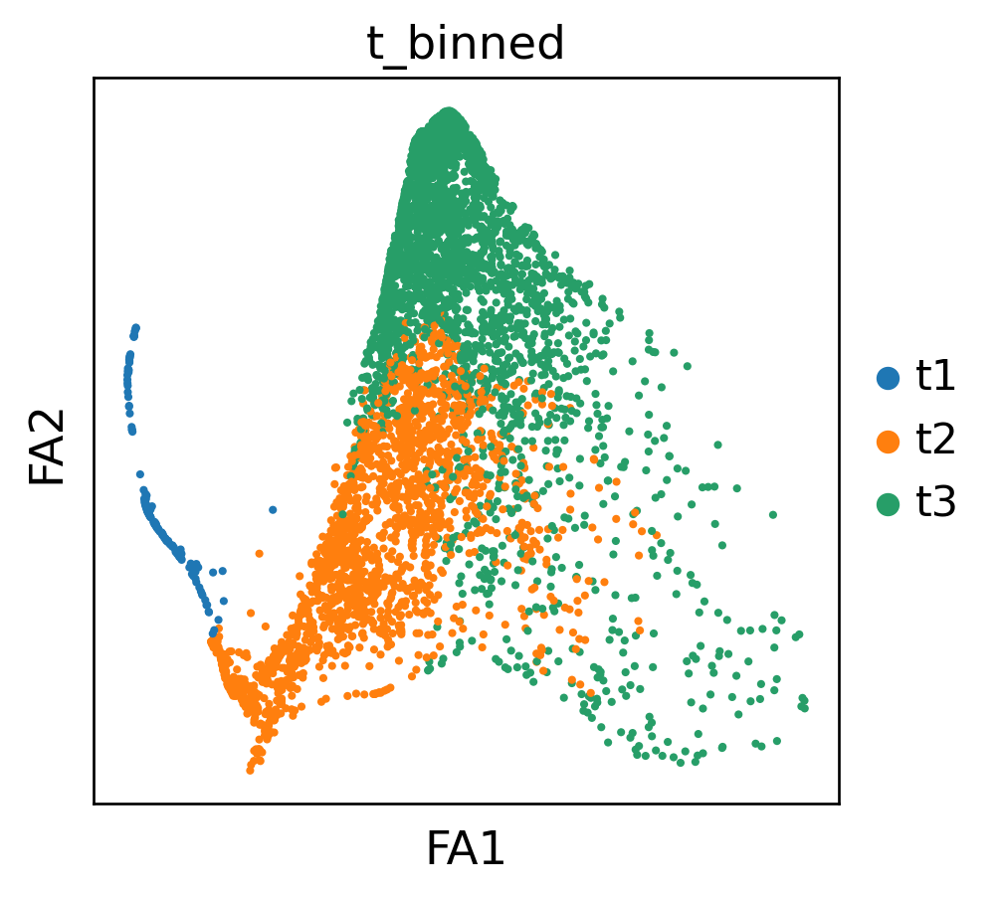

In [13]:
# subset
adata_sub = adata[adata.obs_names[adata.obs['fine_grain']=='VentricularCardiomyocytesLeftTrabeculated']]
print(adata_sub.shape)

# bin t
n_bin_time = 3
adata_sub.obs['t_binned'] = pd.cut(adata_sub.obs['t'],
                               bins=n_bin_time,
                               labels=[f't{str(x+1)}' for x in range(n_bin_time)])
print(adata_sub.obs['t_binned'].value_counts())
sc.pl.draw_graph(adata_sub,color=['t_binned'],color_map="viridis", wspace=0.2)

In [14]:
# save
# RNA
adata_gex = adata_sub[:,adata_sub.var['modality']=='Gene Expression']
adata_gex.write('/nfs/team205/heart/anndata_objects/Vitro/post_multiVI_full-features/Foetal_vCM_Left-trabeculated_rna.h5ad')
print(adata_gex)

# ATAC
adata_atac = adata_sub[:,adata_sub.var['modality']=='Peaks']
adata_atac.write('/nfs/team205/heart/anndata_objects/Vitro/post_multiVI_full-features/Foetal_vCM_Left-trabeculated_atac.h5ad')
print(adata_atac)

View of AnnData object with n_obs × n_vars = 5054 × 36601
    obs: 'sangerID', 'combinedID', 'donor', 'region', 'age', 'sex', 'facility', 'cell_or_nuclei', 'modality', 'kit_10x', 'week', 'trimester', 'cycling', 'S_score', 'G2M_score', 'phase', 'fine_grain', 'mid_grain', 'coarse_grain', 'batch_key', 'total_counts', 'total_counts_mt', 'total_counts_ribo', 'n_genes_by_counts', 'pct_counts_mt', 'pct_counts_ribo', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'log1p_total_counts_mt', 'log1p_total_counts_ribo', 'scrublet_score', 'doublet_pval', 'doublet_bh_pval', '_indices', '_scvi_batch', '_scvi_labels', 'leiden_MultiVI', 't', 'seg', 'edge', 'milestones', 'age_days', 'week_cont', 't_binned'
    var: 'modality', 'gene_name_scRNA-0', 'gene_id', 'seqnames', 'start', 'end', 'width', 'strand', 'score', 'replicateScoreQuantile', 'groupScoreQuantile', 'Reproducibility', 'GroupReplicate', 'distToGeneStart', 'nearestGene', 'peakType', 'distToTSS', 'nearestTSS', 'GC', 'idx', 'N'
    uns: '_scvi_ma

# Other plots

In [4]:
adata = sc.read_h5ad('/nfs/team205/heart/anndata_objects/Foetal/vCM/post_scFate/foetal_vCM_onlyLeft.h5ad')

In [5]:
adata

AnnData object with n_obs × n_vars = 16451 × 544641
    obs: 'sangerID', 'combinedID', 'donor', 'region', 'age', 'sex', 'facility', 'cell_or_nuclei', 'modality', 'kit_10x', 'week', 'trimester', 'cycling', 'S_score', 'G2M_score', 'phase', 'fine_grain', 'mid_grain', 'coarse_grain', 'batch_key', 'total_counts', 'total_counts_mt', 'total_counts_ribo', 'n_genes_by_counts', 'pct_counts_mt', 'pct_counts_ribo', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'log1p_total_counts_mt', 'log1p_total_counts_ribo', 'scrublet_score', 'doublet_pval', 'doublet_bh_pval', '_indices', '_scvi_batch', '_scvi_labels', 'leiden_MultiVI', 't', 'seg', 'edge', 'milestones', 'age_days', 'week_cont'
    var: 'modality', 'gene_name_scRNA-0', 'gene_id', 'seqnames', 'start', 'end', 'width', 'strand', 'score', 'replicateScoreQuantile', 'groupScoreQuantile', 'Reproducibility', 'GroupReplicate', 'distToGeneStart', 'nearestGene', 'peakType', 'distToTSS', 'nearestTSS', 'GC', 'idx', 'N'
    uns: '_scvi_manager_uuid', '_scv

In [ ]:
sns.scatterplot(adata.obs['t'],adata.obs['t'])